<a href="https://colab.research.google.com/github/SangaviGR/TROAD/blob/main/TROAD.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install praw nltk empath pandas prefixspan asyncpraw emoji tabulate plotly

In [ ]:
import re
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
nltk.download('all')

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/abc.zip.
[nltk_data]    | Downloading package alpino to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/alpino.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_eng to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_eng.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_ru.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_rus to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |  

True

In [ ]:
import praw
import nltk
from nltk.tokenize import word_tokenize
from empath import Empath
from prefixspan import PrefixSpan
from collections import defaultdict
from datetime import datetime, timedelta

# 🔹 Initialize Empath for emotion analysis
lexicon = Empath()

# 🔹 Reddit API Setup
reddit = praw.Reddit(
   client_id="A8U6rN952MneQmUhWXSKyw",
    client_secret="V4C5yNDyO9Ez1jq2Osj-zAUy7-Xj7g",
    user_agent="test_script"
)

# 🔹 Fetch user posts and comments from r/depression
subreddit = reddit.subreddit("depression")
user_data = defaultdict(lambda: {'posts': [], 'comments': []})

def extract_emotions(text):
    tokens = word_tokenize(text.lower())
    emotion_scores = lexicon.analyze(" ".join(tokens), normalize=True)
    top_emotions = [emotion for emotion, score in emotion_scores.items() if score > 0.2]
    return top_emotions

for submission in subreddit.top(limit=500):  # Fetch top 500 posts
    author = submission.author
    if author:
        user_data[author]['posts'].append({'text': submission.selftext, 'date': submission.created_utc})

    submission.comments.replace_more(limit=0)
    for comment in submission.comments.list():
        if comment.author:
            user_data[comment.author]['comments'].append({'text': comment.body, 'date': comment.created_utc})

# 🔹 Filter Users with at Least 5 Active Days
min_active_days = 5  # Loosen the filter
filtered_users = {}

for user, activity in user_data.items():
    post_dates = {datetime.utcfromtimestamp(p['date']).date() for p in activity['posts']}
    comment_dates = {datetime.utcfromtimestamp(c['date']).date() for c in activity['comments']}
    active_days = post_dates | comment_dates  # Combine posts and comments

    if len(active_days) >= min_active_days:
        filtered_users[user] = activity

print(f"Total users before filtering: {len(user_data)}")
print(f"Users with at least {min_active_days} active days: {len(filtered_users)}")

# 🔹 Process Emotion Sequences with Sliding Windows
patterns = []
window_size = 3

for user, activity in filtered_users.items():
    sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
    emotions_sequence = [extract_emotions(entry['text']) for entry in sorted_activity]
    emotions_sequence = [e for e in emotions_sequence if e]

    # Apply Sliding Window Approach
    for i in range(len(emotions_sequence) - window_size + 1):
        window = emotions_sequence[i:i + window_size]
        flat_window = [emotion for sublist in window for emotion in sublist]
        patterns.append(flat_window)

# 🔹 Frequent Pattern Mining with PrefixSpan
ps = PrefixSpan(patterns)
frequent_patterns = ps.frequent(3)  # Minimum support of 3 occurrences

print("Frequent Emotional Patterns:", frequent_patterns)


It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/l

Total users before filtering: 33266
Users with at least 5 active days: 831
Frequent Emotional Patterns: [(46, ['giving']), (6, ['giving', 'positive_emotion']), (3, ['giving', 'positive_emotion', 'giving']), (33, ['giving', 'giving']), (19, ['giving', 'giving', 'giving']), (3, ['giving', 'negative_emotion']), (3, ['giving', 'optimism']), (6, ['masculine']), (4, ['masculine', 'communication']), (4, ['masculine', 'communication', 'speaking']), (3, ['masculine', 'communication', 'speaking', 'writing']), (3, ['masculine', 'communication', 'writing']), (4, ['masculine', 'speaking']), (3, ['masculine', 'speaking', 'writing']), (4, ['masculine', 'writing']), (3, ['masculine', 'swearing_terms']), (13, ['communication']), (13, ['communication', 'speaking']), (4, ['communication', 'speaking', 'writing']), (3, ['communication', 'speaking', 'fear']), (3, ['communication', 'speaking', 'giving']), (3, ['communication', 'speaking', 'phone']), (4, ['communication', 'writing']), (3, ['communication', 'f

In [ ]:
import praw
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer
import re
from empath import Empath
from prefixspan import PrefixSpan
from collections import defaultdict
from datetime import datetime, timedelta
import emoji

# 🔹 Initialize Empath for emotion analysis
lexicon = Empath()
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

def preprocess_text(text):
    # Remove HTML tags
    text = re.sub(r'<.*?>', '', text)
    # Extract and replace emojis with their textual representation
    emojis = emoji.distinct_emoji_list(text)
    for em in emojis:
        text = text.replace(em, emoji.demojize(em))
    # Remove special characters (excluding spaces and alphanumeric characters)
    text = re.sub(r'[^\w\s]', '', text)
    # Convert to lowercase
    text = text.lower()
    # Tokenization
    tokens = word_tokenize(text)
    # Remove stopwords
    tokens = [word for word in tokens if word not in stop_words]
    # Stemming and Lemmatization
    tokens = [lemmatizer.lemmatize(stemmer.stem(word)) for word in tokens]
    return ' '.join(tokens)

# 🔹 Reddit API Setup
reddit = praw.Reddit(
   client_id="A8U6rN952MneQmUhWXSKyw",
    client_secret="V4C5yNDyO9Ez1jq2Osj-zAUy7-Xj7g",
    user_agent="test_script"
)

# 🔹 Fetch user posts and comments from r/depression
subreddit = reddit.subreddit("depression")
user_data = defaultdict(lambda: {'posts': [], 'comments': []})

def extract_emotions(text):
    processed_text = preprocess_text(text)
    if not processed_text.strip():  # Skip empty strings
        return []

    tokens = word_tokenize(processed_text)
    emotion_scores = lexicon.analyze(" ".join(tokens), normalize=True) or {}  # Ensure it's a dictionary

    top_emotions = [emotion for emotion, score in emotion_scores.items() if score > 0.2]
    return top_emotions


for submission in subreddit.top(limit=500):  # Fetch top 500 posts
    author = submission.author
    if author:
        user_data[author]['posts'].append({'text': preprocess_text(submission.selftext), 'date': submission.created_utc})

    submission.comments.replace_more(limit=0)
    for comment in submission.comments.list():
        if comment.author:
            user_data[comment.author]['comments'].append({'text': preprocess_text(comment.body), 'date': comment.created_utc})

# 🔹 Filter Users with at Least 5 Active Days
min_active_days = 5  # Loosen the filter
filtered_users = {}

for user, activity in user_data.items():
    post_dates = {datetime.utcfromtimestamp(p['date']).date() for p in activity['posts']}
    comment_dates = {datetime.utcfromtimestamp(c['date']).date() for c in activity['comments']}
    active_days = post_dates | comment_dates  # Combine posts and comments

    if len(active_days) >= min_active_days:
        filtered_users[user] = activity

print(f"Total users before filtering: {len(user_data)}")
print(f"Users with at least {min_active_days} active days: {len(filtered_users)}")

# 🔹 Process Emotion Sequences with Sliding Windows
patterns = []
window_size = 3

for user, activity in filtered_users.items():
    sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
    emotions_sequence = [extract_emotions(entry['text']) for entry in sorted_activity]
    emotions_sequence = [e for e in emotions_sequence if e]

    # Apply Sliding Window Approach
    for i in range(len(emotions_sequence) - window_size + 1):
        window = emotions_sequence[i:i + window_size]
        flat_window = [emotion for sublist in window for emotion in sublist]
        patterns.append(flat_window)

# 🔹 Frequent Pattern Mining with PrefixSpan
ps = PrefixSpan(patterns)
frequent_patterns = ps.frequent(3)  # Minimum support of 3 occurrences

print("Frequent Emotional Patterns:", frequent_patterns)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more

Total users before filtering: 33266
Users with at least 5 active days: 831
Frequent Emotional Patterns: [(161, ['optimism']), (13, ['optimism', 'divine']), (9, ['optimism', 'divine', 'positive_emotion']), (5, ['optimism', 'divine', 'trust']), (4, ['optimism', 'divine', 'giving']), (3, ['optimism', 'divine', 'giving', 'positive_emotion']), (3, ['optimism', 'divine', 'worship']), (3, ['optimism', 'divine', 'worship', 'love']), (3, ['optimism', 'divine', 'worship', 'love', 'affection']), (3, ['optimism', 'divine', 'worship', 'love', 'affection', 'friends']), (3, ['optimism', 'divine', 'worship', 'love', 'affection', 'friends', 'positive_emotion']), (3, ['optimism', 'divine', 'worship', 'love', 'affection', 'positive_emotion']), (3, ['optimism', 'divine', 'worship', 'love', 'friends']), (3, ['optimism', 'divine', 'worship', 'love', 'friends', 'positive_emotion']), (3, ['optimism', 'divine', 'worship', 'love', 'positive_emotion']), (3, ['optimism', 'divine', 'worship', 'affection']), (3, ['

In [ ]:
import praw
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer
import re
from empath import Empath
from prefixspan import PrefixSpan
from collections import defaultdict
from datetime import datetime, timedelta
import emoji

# 🔹 Initialize Empath for emotion analysis
lexicon = Empath()
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

def preprocess_text(text):
    # Remove HTML tags
    text = re.sub(r'<.*?>', '', text)
    # Extract and replace emojis with their textual representation
    emojis = emoji.distinct_emoji_list(text)
    for em in emojis:
        text = text.replace(em, emoji.demojize(em))
    # Remove special characters (excluding spaces and alphanumeric characters)
    text = re.sub(r'[^\w\s]', '', text)
    # Convert to lowercase
    text = text.lower()
    # Tokenization
    tokens = word_tokenize(text)
    # Remove stopwords
    tokens = [word for word in tokens if word not in stop_words]
    # Stemming and Lemmatization
    tokens = [lemmatizer.lemmatize(stemmer.stem(word)) for word in tokens]
    return ' '.join(tokens)

# 🔹 Reddit API Setup
reddit = praw.Reddit(
   client_id="A8U6rN952MneQmUhWXSKyw",
    client_secret="V4C5yNDyO9Ez1jq2Osj-zAUy7-Xj7g",
    user_agent="test_script"
)

# 🔹 Fetch user posts and comments from r/depression
subreddit = reddit.subreddit("depression")
user_data = defaultdict(lambda: {'posts': [], 'comments': []})

def extract_emotions(text):
    processed_text = preprocess_text(text)
    if not processed_text.strip():  # Skip empty strings
        return []

    tokens = word_tokenize(processed_text)
    emotion_scores = lexicon.analyze(" ".join(tokens), normalize=True) or {}  # Ensure it's a dictionary

    top_emotions = [emotion for emotion, score in emotion_scores.items() if score > 0.2]
    return top_emotions

for submission in subreddit.top(limit=500):  # Fetch top 500 posts
    author = submission.author
    if author:
        user_data[author]['posts'].append({'text': preprocess_text(submission.selftext), 'date': submission.created_utc})

    submission.comments.replace_more(limit=0)
    for comment in submission.comments.list():
        if comment.author:
            user_data[comment.author]['comments'].append({'text': preprocess_text(comment.body), 'date': comment.created_utc})

# 🔹 Data Selection and Transformation (ProcessTimeline)
min_active_days = 15  # Adjusted filter based on study assumptions
filtered_users = {}

for user, activity in user_data.items():
    post_dates = {datetime.utcfromtimestamp(p['date']).date() for p in activity['posts']}
    comment_dates = {datetime.utcfromtimestamp(c['date']).date() for c in activity['comments']}
    active_days = post_dates | comment_dates  # Combine posts and comments

    if len(active_days) >= min_active_days:
        filtered_users[user] = activity

print(f"Total users before filtering: {len(user_data)}")
print(f"Users with at least {min_active_days} active days: {len(filtered_users)}")

# 🔹 Process Emotion Sequences with Sliding Windows
patterns = []
window_size = 3

for user, activity in filtered_users.items():
    sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
    emotions_sequence = [extract_emotions(entry['text']) for entry in sorted_activity]
    emotions_sequence = [e for e in emotions_sequence if e]

    # Apply Sliding Window Approach
    for i in range(len(emotions_sequence) - window_size + 1):
        window = emotions_sequence[i:i + window_size]
        flat_window = [emotion for sublist in window for emotion in sublist]
        patterns.append(flat_window)

# 🔹 Frequent Pattern Mining with PrefixSpan
ps = PrefixSpan(patterns)
frequent_patterns = ps.frequent(3)  # Minimum support of 3 occurrences

print("Frequent Emotional Patterns:", frequent_patterns)


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more

Total users before filtering: 33266
Users with at least 15 active days: 43
Frequent Emotional Patterns: [(22, ['optimism']), (7, ['optimism', 'divine']), (4, ['optimism', 'divine', 'positive_emotion']), (3, ['optimism', 'divine', 'worship']), (3, ['optimism', 'divine', 'worship', 'love']), (3, ['optimism', 'divine', 'worship', 'love', 'affection']), (3, ['optimism', 'divine', 'worship', 'love', 'affection', 'friends']), (3, ['optimism', 'divine', 'worship', 'love', 'affection', 'friends', 'positive_emotion']), (3, ['optimism', 'divine', 'worship', 'love', 'affection', 'positive_emotion']), (3, ['optimism', 'divine', 'worship', 'love', 'friends']), (3, ['optimism', 'divine', 'worship', 'love', 'friends', 'positive_emotion']), (3, ['optimism', 'divine', 'worship', 'love', 'positive_emotion']), (3, ['optimism', 'divine', 'worship', 'affection']), (3, ['optimism', 'divine', 'worship', 'affection', 'friends']), (3, ['optimism', 'divine', 'worship', 'affection', 'friends', 'positive_emotion'

In [ ]:
import praw
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer
import re
from empath import Empath
from prefixspan import PrefixSpan
from collections import defaultdict
from datetime import datetime, timedelta
import emoji

# 🔹 Initialize Empath for emotion analysis
lexicon = Empath()
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

def preprocess_text(text):
    # Remove HTML tags
    text = re.sub(r'<.*?>', '', text)
    # Extract and replace emojis with their textual representation
    emojis = emoji.distinct_emoji_list(text)
    for em in emojis:
        text = text.replace(em, emoji.demojize(em))
    # Remove special characters (excluding spaces and alphanumeric characters)
    text = re.sub(r'[^\w\s]', '', text)
    # Convert to lowercase
    text = text.lower()
    # Tokenization
    tokens = word_tokenize(text)
    # Remove stopwords
    tokens = [word for word in tokens if word not in stop_words]
    # Stemming and Lemmatization
    tokens = [lemmatizer.lemmatize(stemmer.stem(word)) for word in tokens]
    return ' '.join(tokens)

# 🔹 Reddit API Setup
reddit = praw.Reddit(
   client_id="A8U6rN952MneQmUhWXSKyw",
    client_secret="V4C5yNDyO9Ez1jq2Osj-zAUy7-Xj7g",
    user_agent="test_script"
)

# 🔹 Fetch user posts and comments from r/depression
subreddit = reddit.subreddit("depression")
user_data = defaultdict(lambda: {'posts': [], 'comments': []})

def extract_emotions(text):
    processed_text = preprocess_text(text)
    if not processed_text.strip():  # Skip empty strings
        return []

    tokens = word_tokenize(processed_text)
    emotion_scores = lexicon.analyze(" ".join(tokens), normalize=True) or {}  # Ensure it's a dictionary

    top_emotions = [emotion for emotion, score in emotion_scores.items() if score > 0.2]
    return top_emotions

for submission in subreddit.top(limit=5000):  # Fetch top 500 posts
    author = submission.author
    if author:
        user_data[author]['posts'].append({'text': preprocess_text(submission.selftext), 'date': submission.created_utc})

    submission.comments.replace_more(limit=0)
    for comment in submission.comments.list():
        if comment.author:
            user_data[comment.author]['comments'].append({'text': preprocess_text(comment.body), 'date': comment.created_utc})

# 🔹 Data Selection and Transformation (ProcessTimeline)
min_active_days = 15  # Adjusted filter based on study assumptions
filtered_users = {}

for user, activity in user_data.items():
    post_dates = {datetime.utcfromtimestamp(p['date']).date() for p in activity['posts']}
    comment_dates = {datetime.utcfromtimestamp(c['date']).date() for c in activity['comments']}
    active_days = post_dates | comment_dates  # Combine posts and comments

    if len(active_days) >= min_active_days:
        filtered_users[user] = activity

print(f"Total users before filtering: {len(user_data)}")
print(f"Users with at least {min_active_days} active days: {len(filtered_users)}")

# 🔹 Process Emotion Sequences with Sliding Windows
patterns = []
window_size = 3

for user, activity in filtered_users.items():
    sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
    emotions_sequence = [extract_emotions(entry['text']) for entry in sorted_activity]
    emotions_sequence = [e for e in emotions_sequence if e]

    # Apply Sliding Window Approach
    for i in range(len(emotions_sequence) - window_size + 1):
        window = emotions_sequence[i:i + window_size]
        flat_window = [emotion for sublist in window for emotion in sublist]
        patterns.append(flat_window)

# 🔹 Frequent Pattern Mining with PrefixSpan
ps = PrefixSpan(patterns)
frequent_patterns = ps.frequent(3)  # Minimum support of 3 occurrences

# print("Frequent Emotional Patterns:", frequent_patterns)
# Save results to a text file
with open("frequent_patterns.txt", "w", encoding="utf-8") as f:
    for pattern, count in frequent_patterns:
        f.write(f"{pattern}: {count}\n")

print("Frequent emotional patterns saved to frequent_patterns.txt")


 the crawler retrieved 415,459 user records, 778,822 posts, and 1,573,858 comments and replies from January 1st, 2009 until July 1st, 2019.

 deidentified, generating random IDs to follow the Ethics protocol defined for this research.

 The average of posts and comments per user is 3.8, but this information is not evenly distributed since a large portion of the users has posted and commented only once in the period we collected the data. Thus, (iii-iv) we filtered the collected data in order to maintain only users that were active in the community for at least 15 days, resulting in 1,212 frequent users.

We call the windows with no user activity silent periods and classify each of them with “silence” in the feature extraction step



The average time interval between two posts in our selected series is of two days and 8 hours. Accordingly, we modeled our approach to work with a time interval of 15 days, which is the minimum number necessary for diagnosing depression [1], [3], and a window size of 3 days. We consider a sequential analysis of users through 5 windows to meet the specialists’ requirements in the analysis of human behavior i.e., psychologists, psychiatrists, and psychotherapists. Bearing in mind that traditional methodologies for inference of mood disorders usually constitute employing questionnaires and interviews on at least 15 days. Specifically considering depression, the manifestation of sadness and other negative symptoms is estimated for two consecutive weeks. This results in 15 days of constant user activity tracking. Accordingly, we set the input parameters of Algorithm 1 interval of days intervalSize=15 and number of windows w=5 .

In [ ]:
import praw
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer
import re
from empath import Empath
from prefixspan import PrefixSpan
from collections import defaultdict
from datetime import datetime, timedelta
import emoji

# 🔹 Initialize Empath for emotion analysis
lexicon = Empath()
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

def preprocess_text(text):
    # Remove HTML tags
    text = re.sub(r'<.*?>', '', text)
    # Extract and replace emojis with their textual representation
    emojis = emoji.distinct_emoji_list(text)
    for em in emojis:
        text = text.replace(em, emoji.demojize(em))
    # Remove special characters (excluding spaces and alphanumeric characters)
    text = re.sub(r'[^\w\s]', '', text)
    # Convert to lowercase
    text = text.lower()
    # Tokenization
    tokens = word_tokenize(text)
    # Remove stopwords
    tokens = [word for word in tokens if word not in stop_words]
    # Stemming and Lemmatization
    tokens = [lemmatizer.lemmatize(stemmer.stem(word)) for word in tokens]
    return ' '.join(tokens)

# 🔹 Reddit API Setup
reddit = praw.Reddit(
   client_id="A8U6rN952MneQmUhWXSKyw",
    client_secret="V4C5yNDyO9Ez1jq2Osj-zAUy7-Xj7g",
    user_agent="test_script"
)

# 🔹 Fetch user posts and comments from r/depression
subreddit = reddit.subreddit("depression")
user_data = defaultdict(lambda: {'posts': [], 'comments': []})

def extract_emotions(text):
    processed_text = preprocess_text(text)
    if not processed_text.strip():  # Skip empty strings
        return []

    tokens = word_tokenize(processed_text)
    emotion_scores = lexicon.analyze(" ".join(tokens), normalize=True) or {}  # Ensure it's a dictionary

    top_emotions = [emotion for emotion, score in emotion_scores.items() if score > 0.2]
    return top_emotions

for submission in subreddit.top(limit=500):  # Fetch top 500 posts
    author = submission.author
    if author:
        user_data[author]['posts'].append({'text': preprocess_text(submission.selftext), 'date': submission.created_utc})

    submission.comments.replace_more(limit=0)
    for comment in submission.comments.list():
        if comment.author:
            user_data[comment.author]['comments'].append({'text': preprocess_text(comment.body), 'date': comment.created_utc})

# 🔹 Data Selection and Transformation (ProcessTimeline)
min_active_days = 15  # Adjusted filter based on study assumptions
filtered_users = {}

for user, activity in user_data.items():
    post_dates = {datetime.utcfromtimestamp(p['date']).date() for p in activity['posts']}
    comment_dates = {datetime.utcfromtimestamp(c['date']).date() for c in activity['comments']}
    active_days = post_dates | comment_dates  # Combine posts and comments

    if len(active_days) >= min_active_days:
        filtered_users[user] = activity

print(f"Total users before filtering: {len(user_data)}")
print(f"Users with at least {min_active_days} active days: {len(filtered_users)}")

# 🔹 Process Emotion Sequences with Sliding Windows
patterns = []
window_size = 3

for user, activity in filtered_users.items():
    sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
    emotions_sequence = [extract_emotions(entry['text']) for entry in sorted_activity]
    emotions_sequence = [e for e in emotions_sequence if e]

    # Apply Sliding Window Approach
    for i in range(len(emotions_sequence) - window_size + 1):
        window = emotions_sequence[i:i + window_size]
        flat_window = [emotion for sublist in window for emotion in sublist]
        patterns.append(flat_window)

# 🔹 Frequent Pattern Mining with PrefixSpan
ps = PrefixSpan(patterns)
frequent_patterns = ps.frequent(3)  # Minimum support of 3 occurrences

# print("Frequent Emotional Patterns:", frequent_patterns)
# 🔹 Compute Statistics
total_users = len(user_data)
total_posts = sum(len(activity['posts']) for activity in user_data.values())
total_comments = sum(len(activity['comments']) for activity in user_data.values())

filtered_user_count = len(filtered_users)
average_posts_comments = (total_posts + total_comments) / filtered_user_count if filtered_user_count else 0

# Print statistics
print(f"The crawler retrieved {total_users} user records, {total_posts} posts, and {total_comments} comments and replies.")
print(f"We filtered the collected data to maintain only users active for at least {min_active_days} days, resulting in {filtered_user_count} frequent users.")
print(f"The average number of posts and comments per user is {average_posts_comments:.1f}.")
print("\nFrequent Emotional Patterns:", frequent_patterns)


In [ ]:
from tabulate import tabulate

# Compute Support, Confidence, and Sequential Confidence
pattern_support = {tuple(s[1]): s[0] for s in frequent_patterns}  # Fix unpacking

def compute_confidence(pattern, support_count):
    if len(pattern) < 2:
        return None  # Confidence doesn't apply to single-item patterns

    prefix = tuple(pattern[:-1])  # All except last item
    prefix_support = pattern_support.get(prefix, 1)  # Avoid division by zero

    return support_count / prefix_support

def compute_sequential_confidence(pattern, support_count):
    if len(pattern) < 2:
        return None  # Sequential confidence not applicable for single-item patterns

    first_item = tuple([pattern[0]])  # Convert first element to tuple
    first_item_support = pattern_support.get(first_item, 1)  # Avoid division by zero

    return support_count / first_item_support

# Prepare data for tabulation
table_data = []
headers = ["Pattern", "Support", "Confidence", "Sequential Confidence"]

for support, pattern in frequent_patterns:
    confidence = compute_confidence(pattern, support)
    sequential_confidence = compute_sequential_confidence(pattern, support)

    table_data.append([
        ", ".join(pattern),  # Convert list to a readable string
        support,
        round(confidence, 3) if confidence else None,
        round(sequential_confidence, 3) if sequential_confidence else None
    ])

# Print results as a table
print(tabulate(table_data, headers=headers, tablefmt="pretty"))

In [ ]:
import praw
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer
import re
from empath import Empath
from prefixspan import PrefixSpan
from collections import defaultdict
from datetime import datetime, timedelta
import emoji

# Initialize Empath for emotion analysis
lexicon = Empath()
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

def preprocess_text(text):
    text = re.sub(r'<.*?>', '', text)
    emojis = emoji.distinct_emoji_list(text)
    for em in emojis:
        text = text.replace(em, emoji.demojize(em))
    text = re.sub(r'[^\w\s]', '', text)
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [word for word in tokens if word not in stop_words]
    tokens = [lemmatizer.lemmatize(stemmer.stem(word)) for word in tokens]
    return ' '.join(tokens)

# Reddit API Setup
reddit = praw.Reddit(
   client_id="A8U6rN952MneQmUhWXSKyw",
    client_secret="V4C5yNDyO9Ez1jq2Osj-zAUy7-Xj7g",
    user_agent="test_script"
)

subreddit = reddit.subreddit("depression")
user_data = defaultdict(lambda: {'posts': [], 'comments': []})

def extract_emotions(text):
    processed_text = preprocess_text(text)
    if not processed_text.strip():
        return []
    tokens = word_tokenize(processed_text)
    emotion_scores = lexicon.analyze(" ".join(tokens), normalize=True) or {}
    top_emotions = [emotion for emotion, score in emotion_scores.items() if score > 0.2]
    return top_emotions

for submission in subreddit.top(limit=100):
    author = submission.author
    if author:
        user_data[author]['posts'].append({'text': preprocess_text(submission.selftext), 'date': submission.created_utc})
    submission.comments.replace_more(limit=0)
    for comment in submission.comments.list():
        if comment.author:
            user_data[comment.author]['comments'].append({'text': preprocess_text(comment.body), 'date': comment.created_utc})

min_active_days = 15
filtered_users = {}
for user, activity in user_data.items():
    post_dates = {datetime.utcfromtimestamp(p['date']).date() for p in activity['posts']}
    comment_dates = {datetime.utcfromtimestamp(c['date']).date() for c in activity['comments']}
    active_days = post_dates | comment_dates
    if len(active_days) >= min_active_days:
        filtered_users[user] = activity

window_sizes = [1, 2, 3, 4, 5]
sequential_patterns = {}

for window_size in window_sizes:
    patterns = []
    for user, activity in filtered_users.items():
        sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
        emotions_sequence = [extract_emotions(entry['text']) for entry in sorted_activity]
        emotions_sequence = [e for e in emotions_sequence if e]

        for i in range(len(emotions_sequence) - window_size + 1):
            window = emotions_sequence[i:i + window_size]
            flat_window = [emotion for sublist in window for emotion in sublist]
            patterns.append(flat_window)

    ps = PrefixSpan(patterns)
    frequent_patterns = ps.frequent(3)
    sequential_patterns[window_size] = frequent_patterns

print("Sequential Patterns Without Silent Periods:")
for w, patterns in sequential_patterns.items():
    print(f"Window Size {w}: {patterns}")

# Adding Silent Periods Analysis
silent_patterns = {}
silent_threshold = timedelta(days=3)

for window_size in window_sizes:
    patterns = []
    for user, activity in filtered_users.items():
        sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
        emotions_sequence = []
        last_date = None

        for entry in sorted_activity:
            curr_date = datetime.utcfromtimestamp(entry['date'])
            if last_date and (curr_date - last_date) > silent_threshold:
                emotions_sequence.append(['silence'])
            emotions_sequence.append(extract_emotions(entry['text']))
            last_date = curr_date

        emotions_sequence = [e for e in emotions_sequence if e]
        for i in range(len(emotions_sequence) - window_size + 1):
            window = emotions_sequence[i:i + window_size]
            flat_window = [emotion for sublist in window for emotion in sublist]
            patterns.append(flat_window)

    ps = PrefixSpan(patterns)
    frequent_patterns = ps.frequent(3)
    silent_patterns[window_size] = frequent_patterns

print("\nSequential Patterns With Silent Periods:")
for w, patterns in silent_patterns.items():
    print(f"Window Size {w}: {patterns}")


In [ ]:
import praw
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer
import re
from empath import Empath
from prefixspan import PrefixSpan
from collections import defaultdict
from datetime import datetime, timedelta
import emoji

# Initialize Empath for emotion analysis
lexicon = Empath()
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

def preprocess_text(text):
    text = re.sub(r'<.*?>', '', text)
    emojis = emoji.distinct_emoji_list(text)
    for em in emojis:
        text = text.replace(em, emoji.demojize(em))
    text = re.sub(r'[^\w\s]', '', text)
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [word for word in tokens if word not in stop_words]
    tokens = [lemmatizer.lemmatize(stemmer.stem(word)) for word in tokens]
    return ' '.join(tokens)

# Reddit API Setup
reddit = praw.Reddit(
   client_id="A8U6rN952MneQmUhWXSKyw",
    client_secret="V4C5yNDyO9Ez1jq2Osj-zAUy7-Xj7g",
    user_agent="test_script"
)

subreddit = reddit.subreddit("depression")
user_data = defaultdict(lambda: {'posts': [], 'comments': []})

def extract_emotions(text):
    processed_text = preprocess_text(text)
    if not processed_text.strip():
        return []
    tokens = word_tokenize(processed_text)
    emotion_scores = lexicon.analyze(" ".join(tokens), normalize=True) or {}
    top_emotions = [emotion for emotion, score in emotion_scores.items() if score > 0.2]
    return top_emotions

for submission in subreddit.top(limit=100):
    author = submission.author
    if author:
        user_data[author]['posts'].append({'text': preprocess_text(submission.selftext), 'date': submission.created_utc})
    submission.comments.replace_more(limit=0)
    for comment in submission.comments.list():
        if comment.author:
            user_data[comment.author]['comments'].append({'text': preprocess_text(comment.body), 'date': comment.created_utc})

min_active_days = 15
filtered_users = {}

for user, activity in user_data.items():
    post_dates = {datetime.utcfromtimestamp(p['date']).date() for p in activity['posts']}
    comment_dates = {datetime.utcfromtimestamp(c['date']).date() for c in activity['comments']}
    active_days = post_dates | comment_dates
    if len(active_days) >= min_active_days:
        filtered_users[user] = activity

print(f"Total users before filtering: {len(user_data)}")
print(f"Users with at least {min_active_days} active days: {len(filtered_users)}")

patterns = []
window_size_range = range(1, 6)

for w in window_size_range:
    for user, activity in filtered_users.items():
        sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
        emotions_sequence = [extract_emotions(entry['text']) for entry in sorted_activity]
        emotions_sequence = [e for e in emotions_sequence if e]
        for i in range(len(emotions_sequence) - w + 1):
            window = emotions_sequence[i:i + w]
            flat_window = [emotion for sublist in window for emotion in sublist]
            patterns.append(flat_window)
    ps = PrefixSpan(patterns)
    frequent_patterns = ps.frequent(3)
    print(f"\nTop-10 Sequential Patterns for w={w}:", frequent_patterns[:10])

# Compute Statistics
filtered_user_count = len(filtered_users)
total_users = len(user_data)
total_posts = sum(len(activity['posts']) for activity in user_data.values())
total_comments = sum(len(activity['comments']) for activity in user_data.values())
average_posts_comments = (total_posts + total_comments) / filtered_user_count if filtered_user_count else 0

print(f"\nThe crawler retrieved {total_users} user records, {total_posts} posts, and {total_comments} comments and replies.")
print(f"We filtered the collected data to maintain only users active for at least {min_active_days} days, resulting in {filtered_user_count} frequent users.")
print(f"The average number of posts and comments per user is {average_posts_comments:.1f}.")


In [ ]:
from tabulate import tabulate

# Compute Support, Confidence, and Sequential Confidence
pattern_support = {tuple(s[1]): s[0] for s in frequent_patterns}  # Fix unpacking

def compute_confidence(pattern, support_count):
    if len(pattern) < 2:
        return None  # Confidence doesn't apply to single-item patterns

    prefix = tuple(pattern[:-1])  # All except last item
    prefix_support = pattern_support.get(prefix, 1)  # Avoid division by zero

    return support_count / prefix_support

def compute_sequential_confidence(pattern, support_count):
    if len(pattern) < 2:
        return None  # Sequential confidence not applicable for single-item patterns

    first_item = tuple([pattern[0]])  # Convert first element to tuple
    first_item_support = pattern_support.get(first_item, 1)  # Avoid division by zero

    return support_count / first_item_support

# Prepare data for tabulation
table_data = []
headers = ["Pattern", "Support", "Confidence", "Sequential Confidence"]

for support, pattern in frequent_patterns:
    confidence = compute_confidence(pattern, support)
    sequential_confidence = compute_sequential_confidence(pattern, support)

    table_data.append([
        ", ".join(pattern),  # Convert list to a readable string
        support,
        round(confidence, 3) if confidence else None,
        round(sequential_confidence, 3) if sequential_confidence else None
    ])

# Print results as a table
print(tabulate(table_data, headers=headers, tablefmt="pretty"))


In [ ]:
from prefixspan import PrefixSpan
from tabulate import tabulate

for w in window_size_range:
    patterns = []

    # Extract sequential emotion patterns for the current window size
    for user, activity in filtered_users.items():
        sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
        emotions_sequence = [extract_emotions(entry['text']) for entry in sorted_activity]
        emotions_sequence = [e for e in emotions_sequence if e]  # Remove empty lists

        for i in range(len(emotions_sequence) - w + 1):
            window = emotions_sequence[i:i + w]
            flat_window = [emotion for sublist in window for emotion in sublist]
            patterns.append(flat_window)

    ps = PrefixSpan(patterns)
    frequent_patterns = ps.frequent(3)  # Get frequent patterns

    # Compute pattern support
    pattern_support = {tuple(s[1]): s[0] for s in frequent_patterns}

    def compute_confidence(pattern, support_count):
        if len(pattern) < 2:
            return 1.0  # Single-item patterns have 100% confidence
        prefix = tuple(pattern[:-1])
        prefix_support = pattern_support.get(prefix, support_count)  # Use support_count instead of 1
        return support_count / prefix_support if prefix_support > 0 else 0

    def compute_sequential_confidence(pattern, support_count):
        if len(pattern) < 2:
            return None  # No sequential confidence for single-item patterns
        first_item = tuple([pattern[0]])
        first_item_support = pattern_support.get(first_item, support_count)  # Safe lookup
        return support_count / first_item_support if first_item_support > 0 else 0

    # Prepare data for tabulation
    table_data = []
    for support, pattern in frequent_patterns:
        confidence = compute_confidence(pattern, support)
        sequential_confidence = compute_sequential_confidence(pattern, support)

        table_data.append([
            ", ".join(pattern),
            support,
            round(confidence, 3) if confidence is not None else "N/A",
            round(sequential_confidence, 3) if sequential_confidence is not None else "N/A"
        ])

    # Sort by Sequential Confidence (Descending) & Print for each window size
    table_data_sorted = sorted(table_data, key=lambda x: (x[3] != "N/A", x[3]), reverse=True)

    print(f"\n🔹 **Discovered Rules Without Silent Periods: Top-10 Sequential Patterns for Window Size w={w}, Ordered by Sequential Confidence**")
    print(tabulate(table_data_sorted[:10], headers=["Pattern", "Support", "Confidence", "Sequential Confidence"], tablefmt="pretty"))


In [ ]:
import praw
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer
import re
from empath import Empath
from prefixspan import PrefixSpan
from collections import defaultdict
from datetime import datetime, timedelta
import emoji
from tabulate import tabulate

# Initialize Empath for emotion analysis
lexicon = Empath()
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()
lemmatizer = WordNetLemmatizer()

def preprocess_text(text):
    text = re.sub(r'<.*?>', '', text)
    emojis = emoji.distinct_emoji_list(text)
    for em in emojis:
        text = text.replace(em, emoji.demojize(em))
    text = re.sub(r'[^\w\s]', '', text)
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [word for word in tokens if word not in stop_words]
    tokens = [lemmatizer.lemmatize(stemmer.stem(word)) for word in tokens]
    return ' '.join(tokens)

# Reddit API Setup
reddit = praw.Reddit(
   client_id="A8U6rN952MneQmUhWXSKyw",
    client_secret="V4C5yNDyO9Ez1jq2Osj-zAUy7-Xj7g",
    user_agent="test_script"
)

subreddit = reddit.subreddit("depression")
user_data = defaultdict(lambda: {'posts': [], 'comments': []})

def extract_emotions(text):
    processed_text = preprocess_text(text)
    if not processed_text.strip():
        return []
    tokens = word_tokenize(processed_text)
    emotion_scores = lexicon.analyze(" ".join(tokens), normalize=True) or {}
    top_emotions = [emotion for emotion, score in emotion_scores.items() if score > 0.2]
    return top_emotions

for submission in subreddit.top(limit=250):
    author = submission.author
    if author:
        user_data[author]['posts'].append({'text': preprocess_text(submission.selftext), 'date': submission.created_utc})
    submission.comments.replace_more(limit=0)
    for comment in submission.comments.list():
        if comment.author:
            user_data[comment.author]['comments'].append({'text': preprocess_text(comment.body), 'date': comment.created_utc})

min_active_days = 15
filtered_users = {}
for user, activity in user_data.items():
    post_dates = {datetime.utcfromtimestamp(p['date']).date() for p in activity['posts']}
    comment_dates = {datetime.utcfromtimestamp(c['date']).date() for c in activity['comments']}
    active_days = post_dates | comment_dates
    if len(active_days) >= min_active_days:
        filtered_users[user] = activity

window_sizes = [1, 2, 3, 4, 5]

def analyze_patterns(filtered_users, include_silence=False):
    sequential_patterns = {}
    silent_threshold = timedelta(days=3)

    for window_size in window_sizes:
        patterns = []
        for user, activity in filtered_users.items():
            sorted_activity = sorted(activity['posts'] + activity['comments'], key=lambda x: x['date'])
            emotions_sequence = []
            last_date = None

            for entry in sorted_activity:
                curr_date = datetime.utcfromtimestamp(entry['date'])
                if include_silence and last_date and (curr_date - last_date) > silent_threshold:
                    emotions_sequence.append(['silence'])
                emotions_sequence.append(extract_emotions(entry['text']))
                last_date = curr_date

            emotions_sequence = [e for e in emotions_sequence if e]
            for i in range(len(emotions_sequence) - window_size + 1):
                window = emotions_sequence[i:i + window_size]
                flat_window = [emotion for sublist in window for emotion in sublist]
                patterns.append(flat_window)

        ps = PrefixSpan(patterns)
        frequent_patterns = ps.frequent(3)
        sequential_patterns[window_size] = frequent_patterns

    return sequential_patterns

# Analyze patterns without and with silent periods
patterns_without_silence = analyze_patterns(filtered_users, include_silence=False)
patterns_with_silence = analyze_patterns(filtered_users, include_silence=True)

def compute_confidence(pattern, support_count, pattern_support):
    if len(pattern) < 2:
        return 1.0  # Single-item patterns have 100% confidence
    prefix = tuple(pattern[:-1])
    prefix_support = pattern_support.get(prefix, support_count)
    return support_count / prefix_support if prefix_support > 0 else 0

def compute_sequential_confidence(pattern, support_count, pattern_support):
    if len(pattern) < 2:
        return None
    first_item = tuple([pattern[0]])
    first_item_support = pattern_support.get(first_item, support_count)
    return support_count / first_item_support if first_item_support > 0 else 0

def display_patterns(patterns, title):
    print(f"\n🔹 {title}")
    for w, frequent_patterns in patterns.items():
        pattern_support = {tuple(s[1]): s[0] for s in frequent_patterns}
        table_data = []
        for support, pattern in frequent_patterns:
            confidence = compute_confidence(pattern, support, pattern_support)
            sequential_confidence = compute_sequential_confidence(pattern, support, pattern_support)
            table_data.append([
                ", ".join(pattern),
                support,
                round(confidence, 3) if confidence is not None else "N/A",
                round(sequential_confidence, 3) if sequential_confidence is not None else "N/A"
            ])
        table_data_sorted = sorted(table_data, key=lambda x: (x[3] != "N/A", x[3]), reverse=True)
        print(f"\nWindow Size {w}:")
        print(tabulate(table_data_sorted[:10], headers=["Pattern", "Support", "Confidence", "Sequential Confidence"], tablefmt="pretty"))

display_patterns(patterns_without_silence, "Discovered Rules Without Silent Periods: Top-10 Sequential Patterns")
display_patterns(patterns_with_silence, "Discovered Rules With Silent Periods: Top-10 Sequential Patterns")

# Compute Statistics
filtered_user_count = len(filtered_users)
total_users = len(user_data)
total_posts = sum(len(activity['posts']) for activity in user_data.values())
total_comments = sum(len(activity['comments']) for activity in user_data.values())
average_posts_comments = (total_posts + total_comments) / filtered_user_count if filtered_user_count else 0

print(f"\nThe crawler retrieved {total_users} user records, {total_posts} posts, and {total_comments} comments and replies.")
print(f"We filtered the collected data to maintain only users active for at least {min_active_days} days, resulting in {filtered_user_count} frequent users.")
print(f"The average number of posts and comments per user is {average_posts_comments:.1f}.")

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more


🔹 Discovered Rules Without Silent Periods: Top-10 Sequential Patterns

Window Size 1:
+----------------------------------------+---------+------------+-----------------------+
|                Pattern                 | Support | Confidence | Sequential Confidence |
+----------------------------------------+---------+------------+-----------------------+
|       optimism, positive_emotion       |    5    |    1.0     |          1.0          |
|         hate, negative_emotion         |    3    |    1.0     |          1.0          |
|        party, positive_emotion         |    4    |    1.0     |          1.0          |
|              help, party               |    3    |    1.0     |          1.0          |
|          help, party, friends          |    3    |    1.0     |          1.0          |
| help, party, friends, positive_emotion |    3    |    1.0     |          1.0          |
|     help, party, positive_emotion      |    3    |    1.0     |          1.0          |
|            

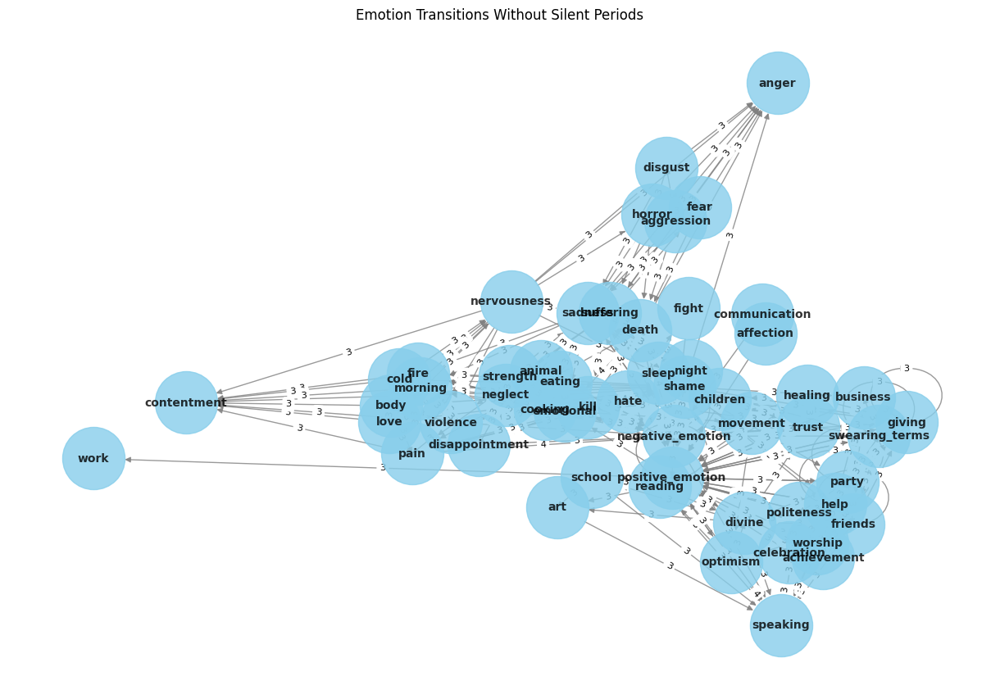

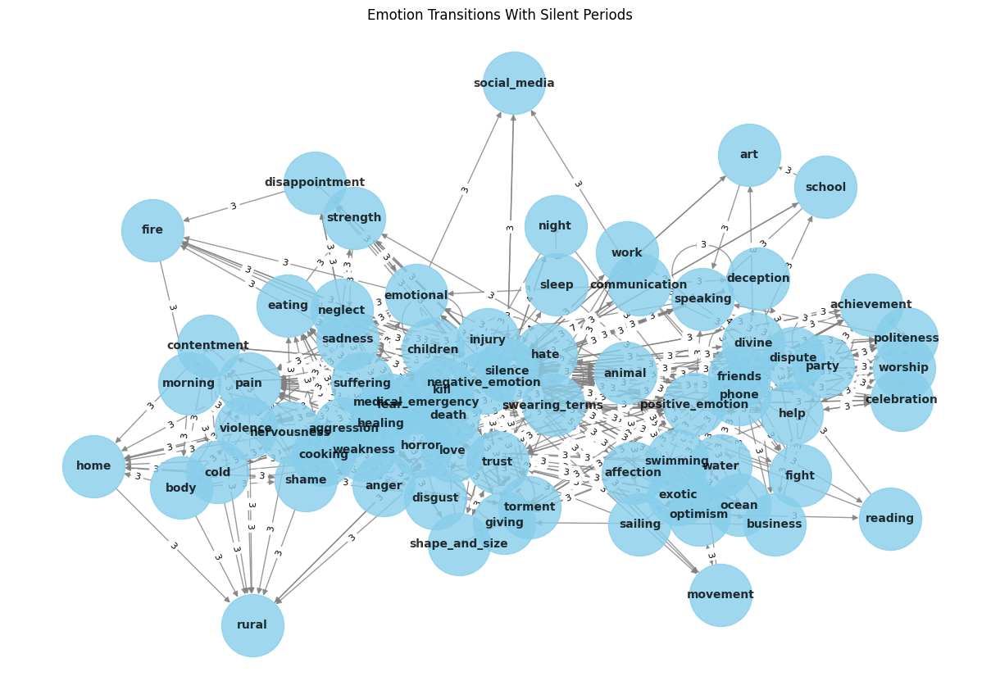

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

def visualize_patterns_as_graph(patterns, title):
    G = nx.DiGraph()  # Directed graph

    for window_size, frequent_patterns in patterns.items():
        for support, pattern in frequent_patterns:
            for i in range(len(pattern) - 1):
                G.add_edge(pattern[i], pattern[i + 1], weight=support)

    plt.figure(figsize=(12, 8))
    pos = nx.spring_layout(G, k=0.5)
    edges = G.edges(data=True)
    edge_labels = {(u, v): f"{d['weight']}" for u, v, d in edges}

    nx.draw(G, pos, with_labels=True, node_color='skyblue', edge_color='gray', node_size=3000, font_size=10, font_weight='bold', alpha=0.8)
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=8)

    plt.title(title)
    plt.show()

visualize_patterns_as_graph(patterns_without_silence, "Emotion Transitions Without Silent Periods")
visualize_patterns_as_graph(patterns_with_silence, "Emotion Transitions With Silent Periods")


In [ ]:
import plotly.graph_objects as go

def visualize_sankey(patterns, title):
    source, target, value = [], [], []
    emotion_indices = {}  # Map emotions to indices for the Sankey diagram

    index = 0
    for _, frequent_patterns in patterns.items():
        for support, pattern in frequent_patterns:
            for i in range(len(pattern) - 1):
                if pattern[i] not in emotion_indices:
                    emotion_indices[pattern[i]] = index
                    index += 1
                if pattern[i+1] not in emotion_indices:
                    emotion_indices[pattern[i+1]] = index
                    index += 1
                source.append(emotion_indices[pattern[i]])
                target.append(emotion_indices[pattern[i+1]])
                value.append(support)

    labels = list(emotion_indices.keys())
    fig = go.Figure(go.Sankey(
        node=dict(label=labels, color="lightblue"),
        link=dict(source=source, target=target, value=value)
    ))

    fig.update_layout(title_text=title, font_size=10)
    fig.show()

visualize_sankey(patterns_without_silence, "Emotion Flow Without Silent Periods")

In [ ]:
visualize_sankey(patterns_with_silence, "Emotion Flow With Silent Periods")

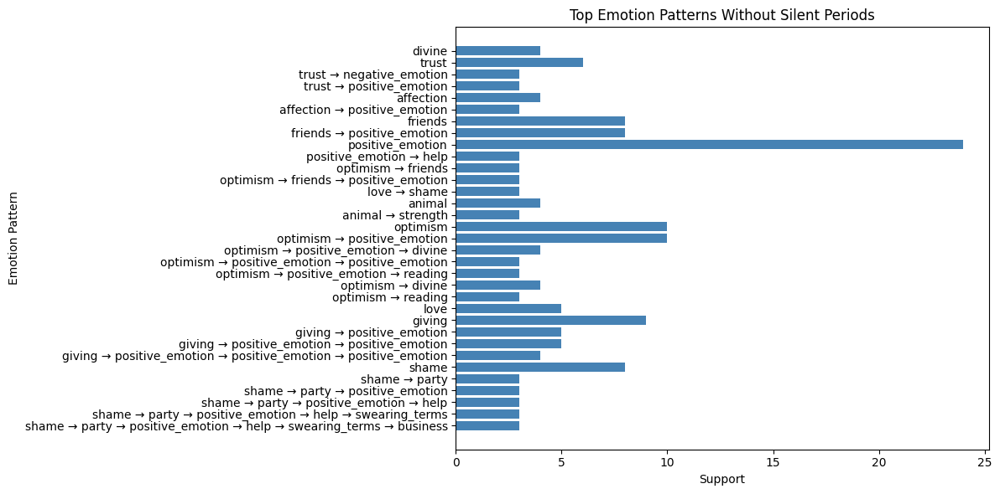

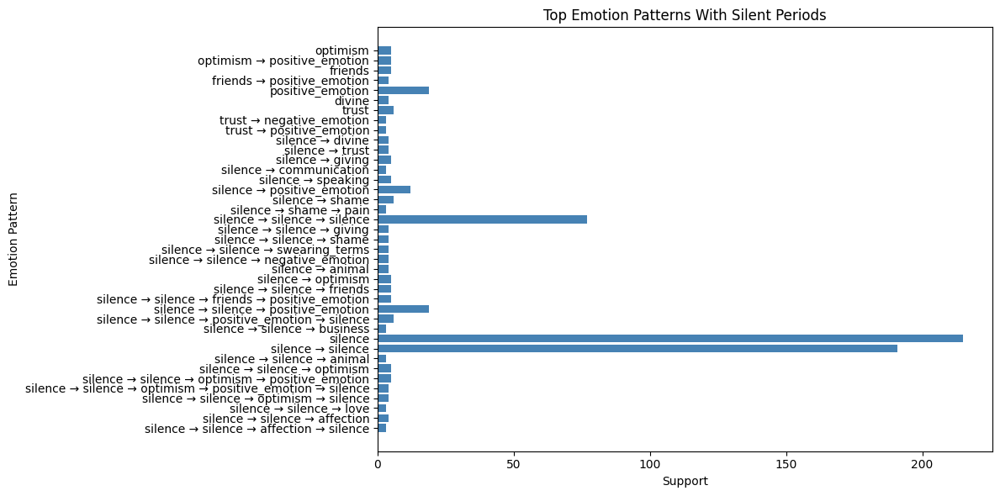

In [ ]:
import matplotlib.pyplot as plt

def visualize_top_patterns(patterns, title):
    pattern_labels = []
    pattern_support = []

    for _, frequent_patterns in patterns.items():
        for support, pattern in frequent_patterns[:10]:  # Top 10 patterns
            pattern_labels.append(" → ".join(pattern))
            pattern_support.append(support)

    plt.figure(figsize=(12, 6))
    plt.barh(pattern_labels[::-1], pattern_support[::-1], color="steelblue")  # Reverse for better display
    plt.xlabel("Support")
    plt.ylabel("Emotion Pattern")
    plt.title(title)
    plt.tight_layout()
    plt.show()

visualize_top_patterns(patterns_without_silence, "Top Emotion Patterns Without Silent Periods")
visualize_top_patterns(patterns_with_silence, "Top Emotion Patterns With Silent Periods")


In [ ]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go

# Function to extract patterns from the discovered sequences
def get_sankey_data(patterns):
    links = []
    labels = []
    label_index = {}

    for window_size, frequent_patterns in patterns.items():
        for support, pattern in frequent_patterns[:10]:  # Take top 10 patterns
            for i in range(len(pattern) - 1):
                source, target = pattern[i], pattern[i + 1]

                # Ensure source and target are in labels
                if source not in label_index:
                    label_index[source] = len(labels)
                    labels.append(source)
                if target not in label_index:
                    label_index[target] = len(labels)
                    labels.append(target)

                # Append link data
                links.append({
                    "source": label_index[source],
                    "target": label_index[target],
                    "value": support
                })

    return labels, links

# Extract data for Sankey diagram
labels, links = get_sankey_data(patterns_without_silence)

# Create Sankey diagram using Plotly
fig = go.Figure(go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=labels
    ),
    link=dict(
        source=[link['source'] for link in links],
        target=[link['target'] for link in links],
        value=[link['value'] for link in links]
    )
))

fig.update_layout(title_text="Emotion Flow in Depression Subreddit (Without Silent Periods)", font_size=12)
fig.show()


In [ ]:
# Extract data for Sankey diagram
labels, links = get_sankey_data(patterns_with_silence)

# Create Sankey diagram using Plotly
fig = go.Figure(go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=labels
    ),
    link=dict(
        source=[link['source'] for link in links],
        target=[link['target'] for link in links],
        value=[link['value'] for link in links]
    )
))

fig.update_layout(title_text="Emotion Flow in Depression Subreddit (With Silent Periods)", font_size=12)
fig.show()
